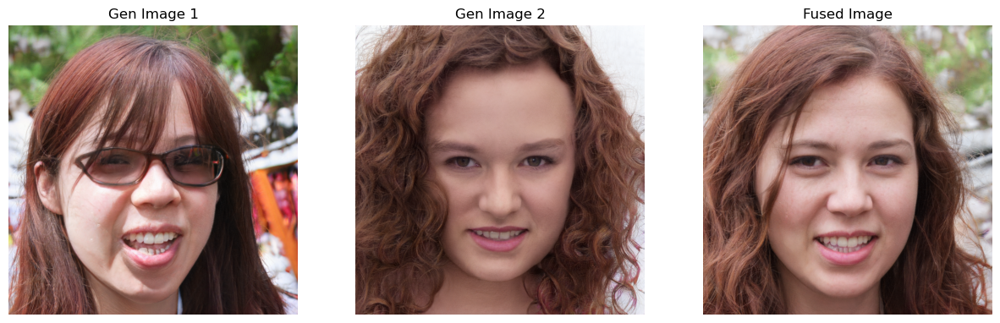

In [17]:
import torch
from dnnlib import util
import legacy
import numpy as np
import matplotlib.pyplot as plt

def load_model(model_path):
    with util.open_url(model_path) as f:
        generator = legacy.load_network_pkl(f)['G_ema'].cuda()  # Load generator
    return generator

def generate_latent_vector(generator, seed, label=None):
    # Generate Z vector
    z = torch.from_numpy(np.random.RandomState(seed).randn(1, generator.z_dim)).to(torch.float32).cuda()
    
    # Generate conditional label tensor if label is provided and generator is conditional
    if label is not None and generator.c_dim > 0:
        c = torch.nn.functional.one_hot(torch.tensor([label]), num_classes=generator.c_dim).to(torch.float32).cuda()
    else:
        c = None  # No label tensor needed for unconditional GAN

    # Generate W vector
    w = generator.mapping(z, c)
    return w

def generate_image_from_vector(generator, vector):
    with torch.no_grad():
        generated_image = generator.synthesis(vector)
    generated_image = (generated_image.permute(0, 2, 3, 1).clamp(min=-1, max=1) + 1) / 2
    return generated_image[0].cpu().numpy()

def interpolate_vectors(vec1, vec2, alpha):
    return vec1 * (1 - alpha) + vec2 * alpha

ALPHA = 0.5  # Interpolation factor
seed_1 = 106  # Seed for the first image
seed_2 = 62  # Seed for the second image
class_1 = None  # Class for the first image
class_2 = 8  # Class for the second image

# Load your StyleGAN3 model

G = load_model('models/StyleGan2/stylegan2-ffhq-1024x1024.pkl')
G2 = load_model('models/L24_31classes_512_2.pkl')

latent_vector_1 = generate_latent_vector(G, seed_1, class_1)
latent_vector_2 = generate_latent_vector(G, seed_2, class_2)

# Interpolate between the two latent vectors
interpolated_vector = interpolate_vectors(latent_vector_1, latent_vector_2, ALPHA)

# Generate an image from the interpolated vector
with torch.no_grad():
    generated_image = G.synthesis(interpolated_vector)

# Convert the generated image for visualization
generated_image = (generated_image.permute(0, 2, 3, 1).clamp(min=-1, max=1) + 1) / 2
generated_image_np = generated_image[0].cpu().numpy()
# Generate images for each latent vector
image_1 = generate_image_from_vector(G, latent_vector_1)
image_2 = generate_image_from_vector(G, latent_vector_2)
fused_image = generate_image_from_vector(G, interpolated_vector)

# Plotting the images side by side
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].imshow(image_1)
ax[0].set_title("Gen Image 1")
ax[0].axis('off')

ax[1].imshow(image_2)
ax[1].set_title("Gen Image 2")
ax[1].axis('off')

ax[2].imshow(fused_image)
ax[2].set_title("Fused Image")
ax[2].axis('off')

plt.show()

In [3]:
print(f'latent_vector_1.shape = {latent_vector_1.shape}')
print(f'latent_vector_2.shape = {latent_vector_2.shape}')

latent_vector_1.shape = torch.Size([1, 18, 512])
latent_vector_2.shape = torch.Size([1, 16, 512])


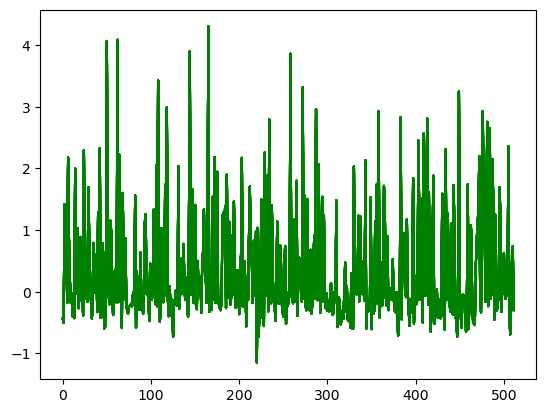

In [14]:
for i in range(16):
    plt.plot(latent_vector_1[0, i].cpu(), color='green',label='latent_vector_1')

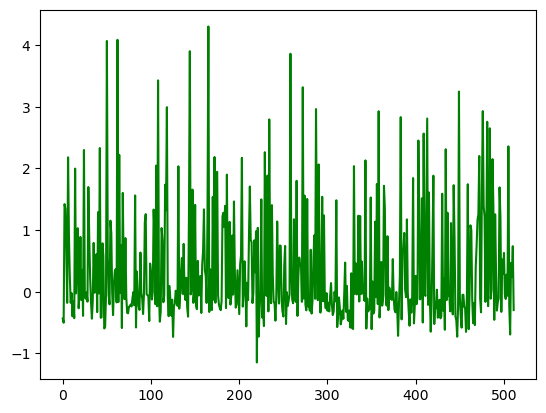

In [18]:
plt.plot(latent_vector_1[0, 0].cpu(), color='green',label='latent_vector_1')

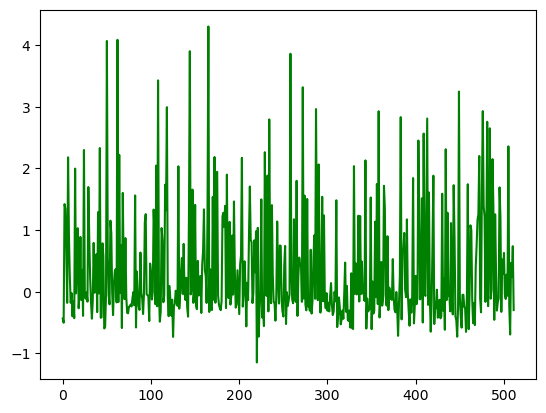

In [19]:
plt.plot(latent_vector_1[0, 1].cpu(), color='green',label='latent_vector_1')

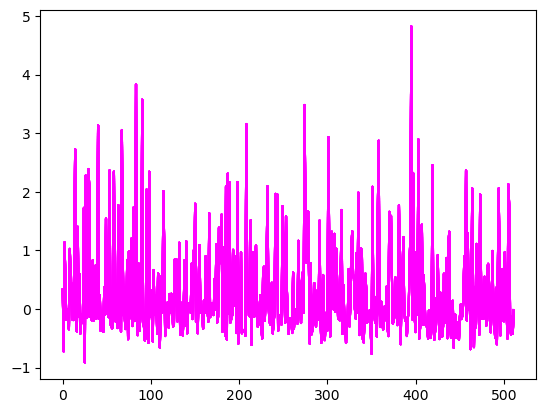

In [16]:
for i in range(16):
    plt.plot(latent_vector_2[0, i].cpu(), color='magenta',label='latent_vector_2')

In [9]:
# latent_vector_1[0, 0, 0]
latent_vector_1_copy = latent_vector_1.clone()
interpolated_vector_copy = interpolated_vector.clone()

In [10]:
latent_vector_1_copy[0, 1] = interpolated_vector_copy[0, 1]

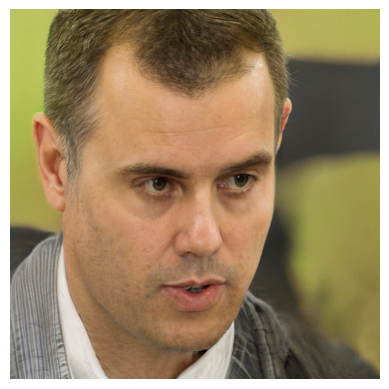

In [11]:
plt.axis('off')
plt.imshow(generate_image_from_vector(G, latent_vector_1_copy))
plt.show()

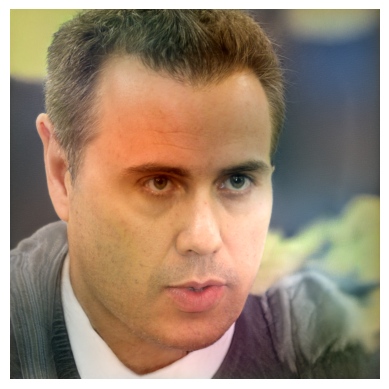

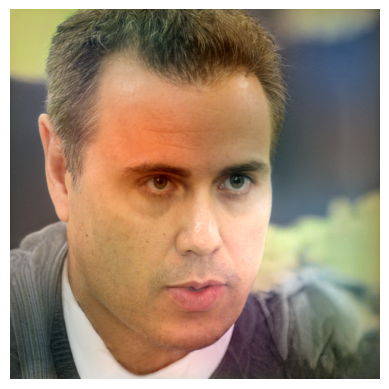

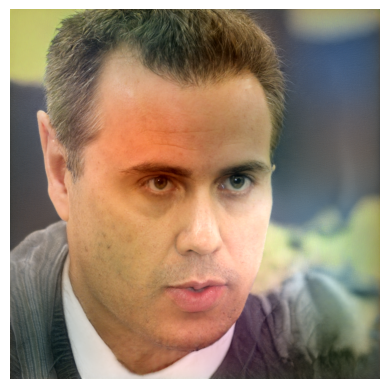

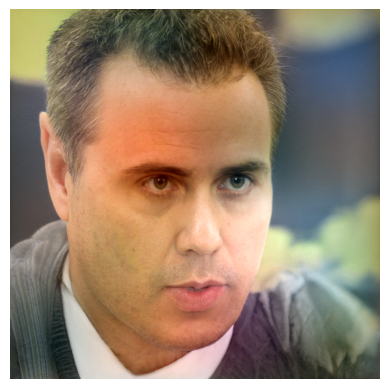

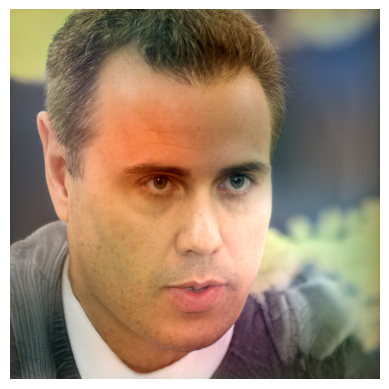

...

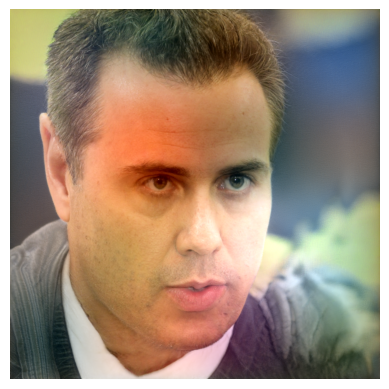

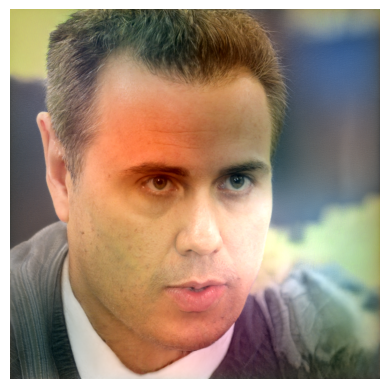

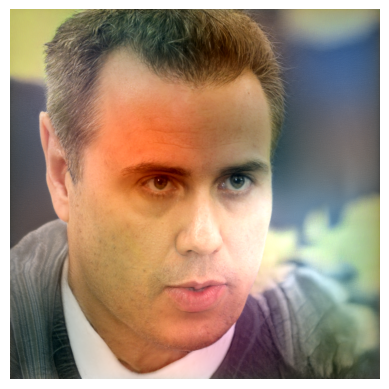

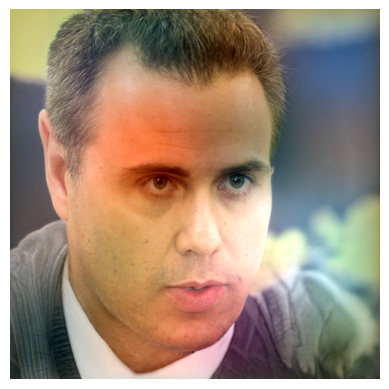

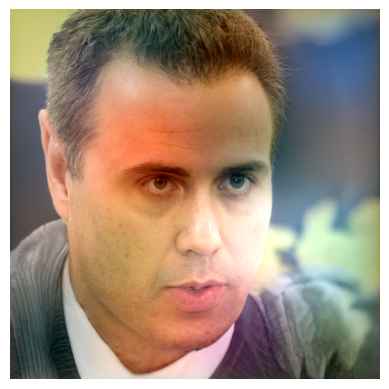

In [14]:
for i in range (18):
    latent_vector_1_copy[0, 1] = latent_vector_1_copy[0, 1] +0.5
    plt.axis('off')
    plt.imshow(generate_image_from_vector(G, latent_vector_1_copy))
    plt.show()

Setting up PyTorch plugin "filtered_lrelu_plugin"... Done.
Iteration 0, Loss: 2.6656222343444824
Iteration 100, Loss: 0.05779705196619034
Iteration 200, Loss: 0.04693188518285751
Iteration 300, Loss: 0.04162433743476868
Iteration 400, Loss: 0.03917856514453888
Iteration 500, Loss: 0.041674286127090454
Iteration 600, Loss: 0.04049026221036911
Iteration 700, Loss: 0.03956155106425285
Iteration 800, Loss: 0.036800235509872437
Iteration 900, Loss: 0.034055717289447784
Iteration 1000, Loss: 0.033320359885692596
Iteration 1100, Loss: 0.03511036932468414
Iteration 1200, Loss: 0.032043516635894775
Iteration 1300, Loss: 0.03157004341483116
Iteration 1400, Loss: 0.03285970538854599
Iteration 1500, Loss: 0.03080531768500805
Iteration 1600, Loss: 0.03010539710521698
Iteration 1700, Loss: 0.03012576512992382
Iteration 1800, Loss: 0.03163256496191025
Iteration 1900, Loss: 0.030638141557574272
Iteration 2000, Loss: 0.02796091139316559
Iteration 2100, Loss: 0.028280604630708694
Iteration 2200, Loss: 0

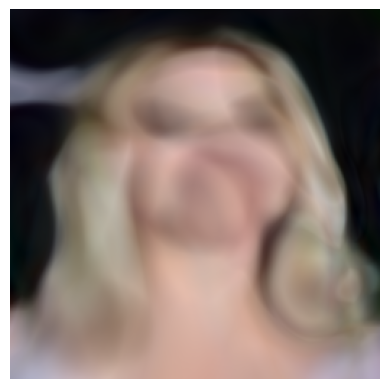

In [1]:
import torch
from torchvision import transforms
from PIL import Image
import torch.optim as optim
from dnnlib import util
import legacy
from matplotlib import pyplot as plt

def load_model(model_path):
    with util.open_url(model_path) as f:
        generator = legacy.load_network_pkl(f)['G_ema'].cuda()  # Load generator
    return generator

def load_image(image_path):
    img = Image.open(image_path).convert('RGB')
    transform = transforms.Compose([
        transforms.Resize((256, 256)),  # Adjust size to match GAN input
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])  # Normalize if needed
    ])
    return transform(img).unsqueeze(0).to('cuda')

def generate_image_from_vector(generator, vector):
    with torch.no_grad():
        generated_image = generator.synthesis(vector)
    generated_image = (generated_image.permute(0, 2, 3, 1).clamp(min=-1, max=1) + 1) / 2
    return generated_image[0].cpu().numpy()

def optimize_latent_vector(generator, target_image, iterations=20000, lr=0.01):
    latent_vector = torch.randn([1, generator.num_ws, generator.z_dim], device='cuda', requires_grad=True)
    optimizer = optim.Adam([latent_vector], lr=lr)

    for iteration in range(iterations):
        optimizer.zero_grad()

        # Generate image from latent vector
        # If your generator takes W space instead of Z, modify this part accordingly
        generated_image = generator.synthesis(latent_vector)

        # Calculate loss (Mean Squared Error here as an example)
        loss = torch.nn.functional.mse_loss(generated_image, target_image)

        # Backpropagation
        loss.backward()
        optimizer.step()

        if iteration % 100 == 0:
            print(f"Iteration {iteration}, Loss: {loss.item()}")

    return latent_vector


    return latent_vector
def display_image(image):
    plt.axis('off')
    plt.imshow(image)
    plt.show()
    
# Load your model
G = load_model('models/stylegan3-r-ffhqu-256x256.pkl')

# Load and preprocess target image
target_image = load_image('/home/me/Downloads/579067_v9_bb.jpg')

# Optimize the latent vector
optimized_latent_vector = optimize_latent_vector(G, target_image)

# Generate and display final image
final_image = generate_image_from_vector(G, optimized_latent_vector)
display_image(final_image)


In [ ]:
from matplotlib import pyplot as plt

def generate_image_from_vector(generator, vector):
    with torch.no_grad():
        generated_image = generator.synthesis(vector)
    generated_image = (generated_image.permute(0, 2, 3, 1).clamp(min=-1, max=1) + 1) / 2
    return generated_image[0].cpu().numpy()

final_image = generate_image_from_vector(G, optimized_latent_vector)
display_image(final_image)

In [ ]:
import torch
import numpy as np
import PIL.Image
import matplotlib.pyplot as plt
import dnnlib
import legacy

def load_model(model_path):
    with dnnlib.util.open_url(model_path) as f:
        generator = legacy.load_network_pkl(f)['G_ema'].cuda()  # Load generator
    return generator

def generate_image(G, z, truncation_psi, class_idx=None):
    # Generate conditional label tensor if label is provided and generator is conditional
    if class_idx is not None and G.c_dim > 0:
        label = torch.zeros([1, G.c_dim], device='cuda')
        label[:, class_idx] = 1
    else:
        label = None  # No label tensor needed for unconditional GAN

    # Generate image
    with torch.no_grad():
        img = G(z, label, truncation_psi=truncation_psi, noise_mode='const')
    img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
    return PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB')

def generate_image_from_vector(generator, vector):
    with torch.no_grad():
        generated_image = generator.synthesis(vector)
    generated_image = (generated_image.permute(0, 2, 3, 1).clamp(min=-1, max=1) + 1) / 2
    return generated_image[0].cpu().numpy()

def seed2vec(G, seed):
    return torch.from_numpy(np.random.RandomState(seed).randn(1, G.z_dim)).to('cuda')

def display_image(image):
    plt.axis('off')
    plt.imshow(image)
    plt.show()

def generate_image(G, z, truncation_psi, class_idx=None):
    if class_idx is not None and G.c_dim > 0:
        label = torch.zeros([1, G.c_dim], device='cuda')
        label[:, class_idx] = 1
    else:
        label = None

    # Generate image
    with torch.no_grad():
        img = G(z, label, truncation_psi=truncation_psi, noise_mode='const')
    img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
    return PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB')

# Example usage
device = 'cuda'
# G = load_model('L24_31classes_512_2.pkl')  # Load your model
z = seed2vec(G2, seed=45)  # Generate a latent vector from a seed
truncation_psi = 1.0
class_idx = 17  # Specify class index if your model is conditional
image = generate_image(G2, z, truncation_psi, class_idx)
display_image(image)


/home/me/anaconda3/envs/stylegan3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


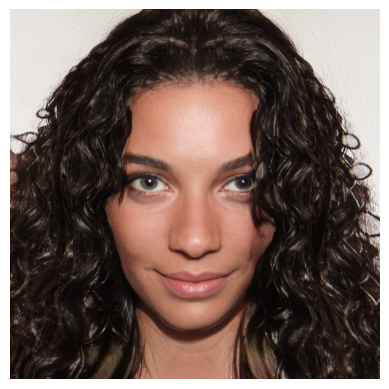

36


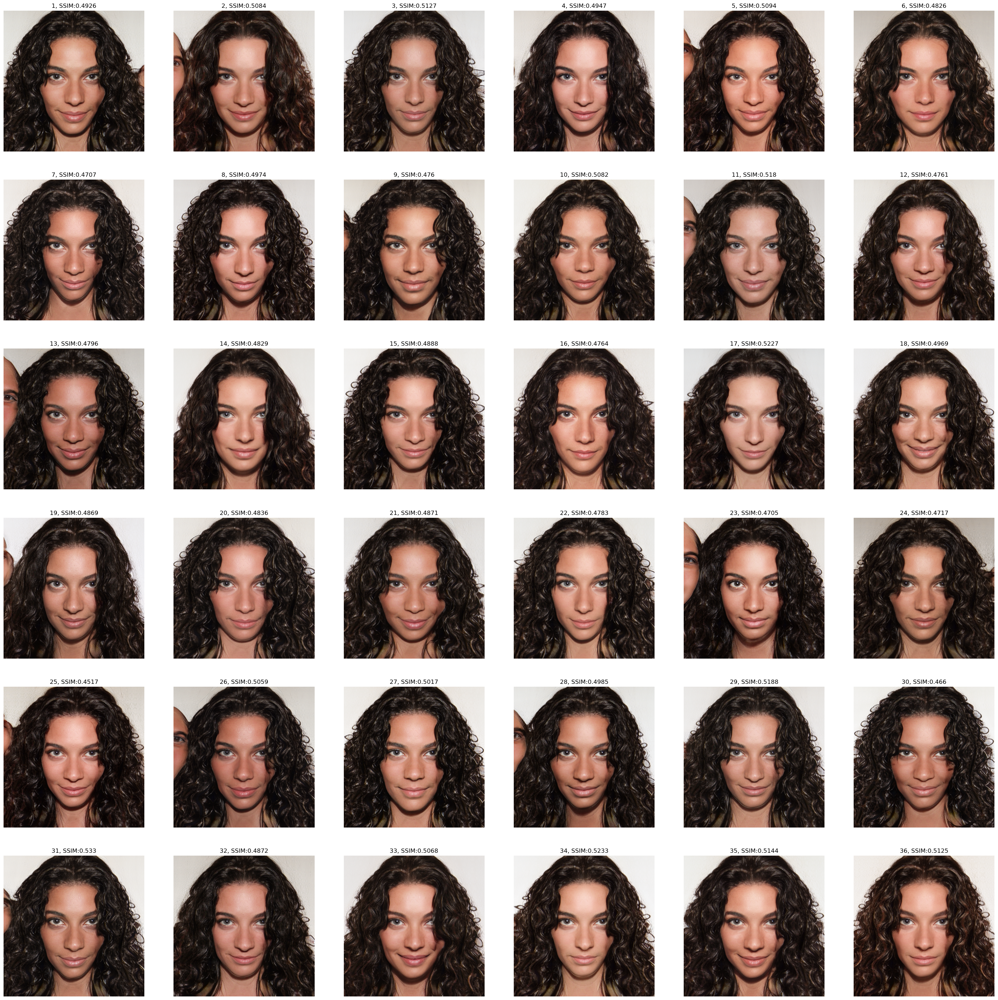

In [38]:
from dnnlib import util
from torch.nn.functional import cosine_similarity
from torchvision import models, transforms
from PIL import Image
from skimage.metrics import structural_similarity as ssim
import numpy as np
import legacy
import torch
from matplotlib import pyplot as plt

def load_model(model_path):
    with util.open_url(model_path) as f:
        generator = legacy.load_network_pkl(f)['G_ema'].cuda()  # Load generator
    return generator

def generate_latent_vector(generator, seed, label=None):
    # Generate Z vector
    z = torch.from_numpy(np.random.RandomState(seed).randn(1, generator.z_dim)).to(torch.float32).cuda()
    
    # Generate conditional label tensor if label is provided and generator is conditional
    if label is not None and generator.c_dim > 0:
        c = torch.nn.functional.one_hot(torch.tensor([label]), num_classes=generator.c_dim).to(torch.float32).cuda()
    else:
        c = None  # No label tensor needed for unconditional GAN

    # Generate W vector
    w = generator.mapping(z, c)
    return w

def generate_image_from_vector(generator, vector):
    with torch.no_grad():
        generated_image = generator.synthesis(vector)
    generated_image = (generated_image.permute(0, 2, 3, 1).clamp(min=-1, max=1) + 1) / 2
    return generated_image[0].cpu().numpy()

def calculate_ssim(image1, image2):
    image1_gray = np.dot(image1[..., :3], [0.2989, 0.5870, 0.1140])
    image2_gray = np.dot(image2[..., :3], [0.2989, 0.5870, 0.1140])
    return ssim(image1_gray, image2_gray, data_range=image1_gray.max() - image1_gray.min())

def display_image(image):
    plt.axis('off')
    plt.imshow(image)
    plt.show()

# Load the pre-trained InceptionV3 model
inception_model = models.inception_v3(weights=True, transform_input=False).to('cuda')
inception_model.eval()

def preprocess_image_for_inceptionV3(img_np):
    # Convert numpy image to PIL Image
    img = Image.fromarray((img_np * 255).astype(np.uint8))
    
    # Define transformations
    preprocess = transforms.Compose([
        transforms.Resize(299),
        transforms.CenterCrop(299),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])
    
    # Apply transformations
    img_tensor = preprocess(img).unsqueeze(0).to('cuda')
    return img_tensor

def extract_features(img_np, model):
    img_tensor = preprocess_image_for_inceptionV3(img_np)
    with torch.no_grad():
        features = model(img_tensor)
    return features.cpu().numpy()


START_SEED = 100
class_idx = 8
EXPLORE_SIZE = 36
SCALE = 0.25
G = load_model('models/stylegan3-t-ffhq-1024x1024.pkl')
latent_vector = generate_latent_vector(G, START_SEED, class_idx)
img_fake = generate_image_from_vector(G, latent_vector)
display_image(img_fake)
original_features = extract_features(img_fake, inception_model)
features = extract_features(img_fake, inception_model)

def calculate_cosine_similarity(feature1, feature2):
    # Ensure the feature vectors are 2D
    if feature1.ndim == 1:
        feature1 = feature1.reshape(1, -1)
    if feature2.ndim == 1:
        feature2 = feature2.reshape(1, -1)

    # Convert to PyTorch tensors
    feature1 = torch.from_numpy(feature1).to('cuda')
    feature2 = torch.from_numpy(feature2).to('cuda')

    # Calculate cosine similarity
    return cosine_similarity(feature1, feature2).item()

explore = [torch.randn(1, G.z_dim).cuda() for _ in range(EXPLORE_SIZE)]
current = generate_latent_vector(G, START_SEED, class_idx)

norm_2_differences = []

images = []
for i, mv in enumerate(explore):
    z = current + SCALE * mv
    # Compute the norm-2 difference
    difference = torch.norm(z - current, p=2)  
    norm_2_differences.append(difference.item())  
    img = generate_image_from_vector(G, z)
    images.append(img)

ssim_scores = []
cosine_scores = []

i = -1
k = 0
fig, axes = plt.subplots(int(np.sqrt(EXPLORE_SIZE)), int(np.sqrt(EXPLORE_SIZE)), figsize=(36, 36))  
for ax, img in zip(axes.flatten(), images):
    i = i + 1
    img_features = extract_features(img, inception_model)
    ssim_score = calculate_ssim(img_fake, img)
    cosine_score = calculate_cosine_similarity(original_features, img_features)
    ssim_scores.append(ssim_score)
    cosine_scores.append(cosine_score)
 
    k = k + 1
    ax.imshow(img)
    ax.title.set_text( f"{k}, SSIM:{np.round((ssim_score), 4)}")
    ax.axis('off')
print(k)
plt.show()

/home/me/anaconda3/envs/stylegan3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


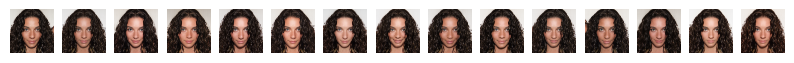

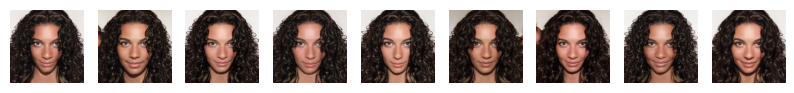

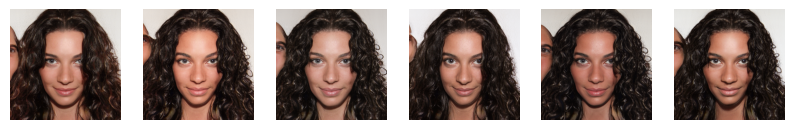

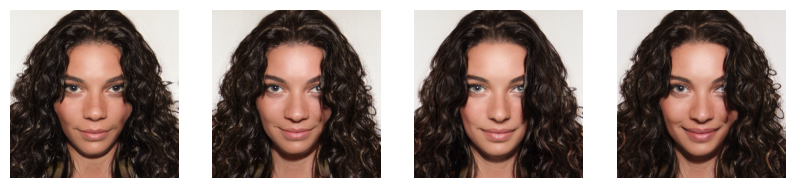

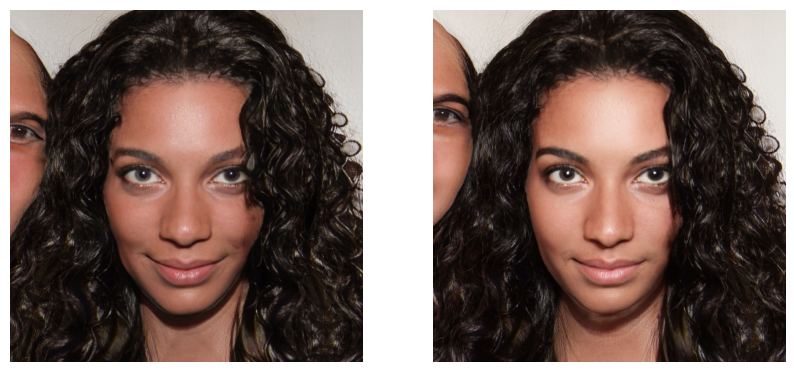

In [39]:
from sklearn.metrics import pairwise_distances
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import numpy as np

# Assuming 'images' is a list of generated images in numpy array format
# Flatten each image into a 1D array for distance calculation
flattened_images = [img.reshape(-1) for img in images]

# Calculate pairwise distances using Euclidean metric
# You can change 'euclidean' to 'cosine' or use a custom function for SSIM
distance_matrix = pairwise_distances(flattened_images, metric='cosine')

# Number of clusters
num_clusters = 5  # Adjust this based on your data

# Perform clustering
kmeans = KMeans(n_clusters=num_clusters)
cluster_labels = kmeans.fit_predict(distance_matrix)

# Plotting the clusters
for i in range(num_clusters):
    cluster_images = np.array(images)[cluster_labels == i]
    plt.figure(figsize=(10, 10))
    for j, img in enumerate(cluster_images):
        plt.subplot(1, len(cluster_images), j+1)
        plt.imshow(img)
        plt.axis('off')
    plt.show()


/home/me/anaconda3/envs/stylegan3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


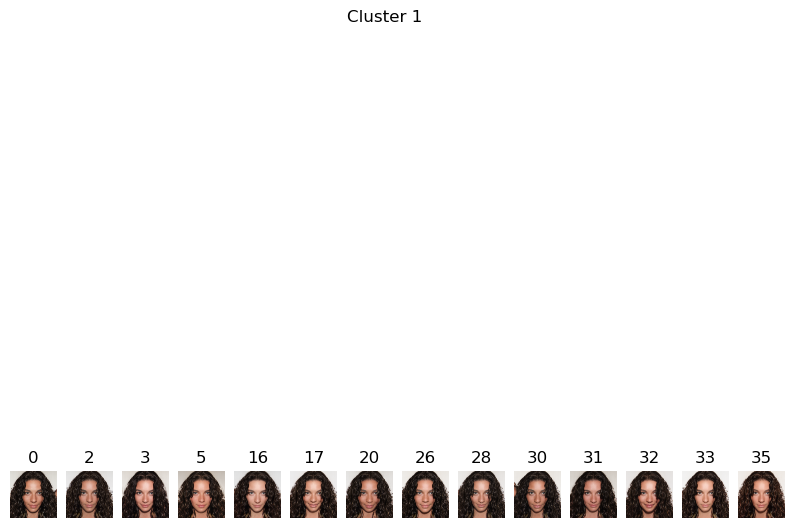

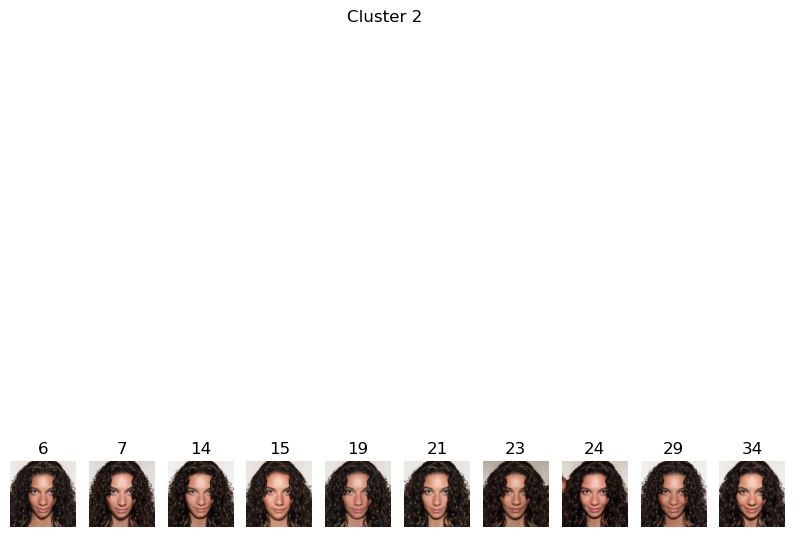

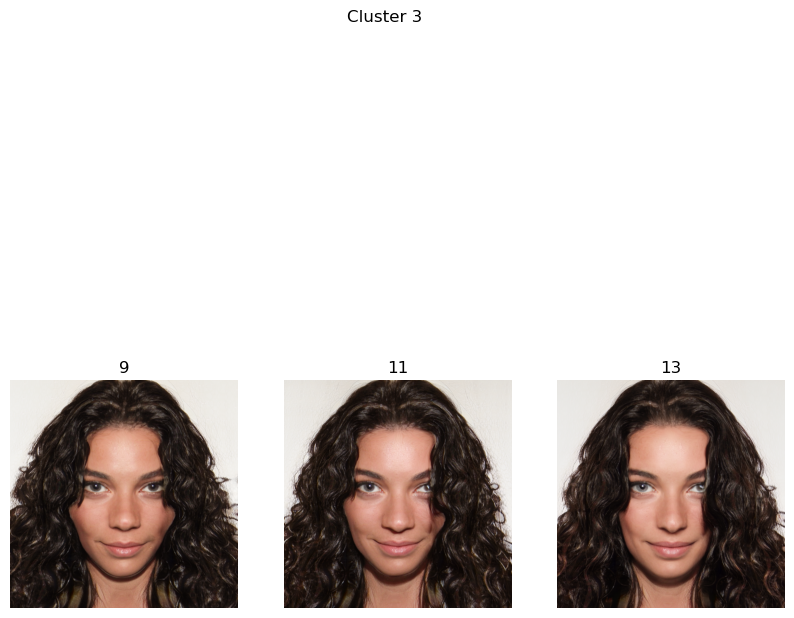

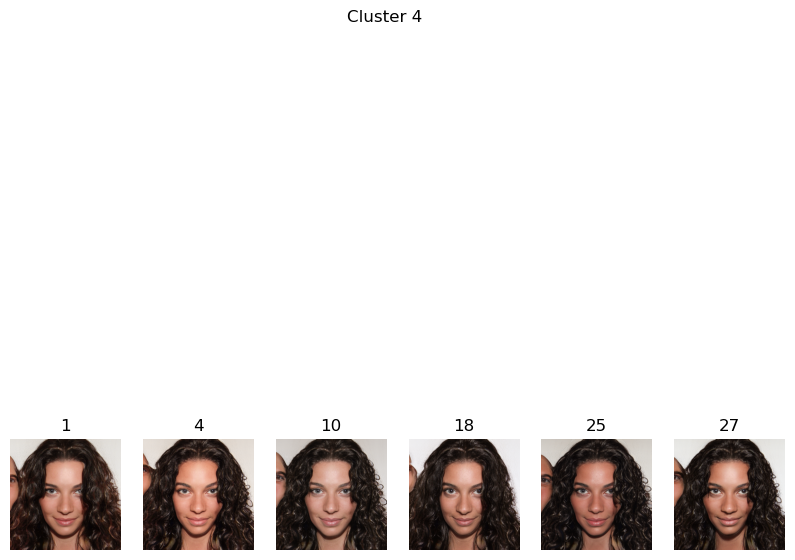

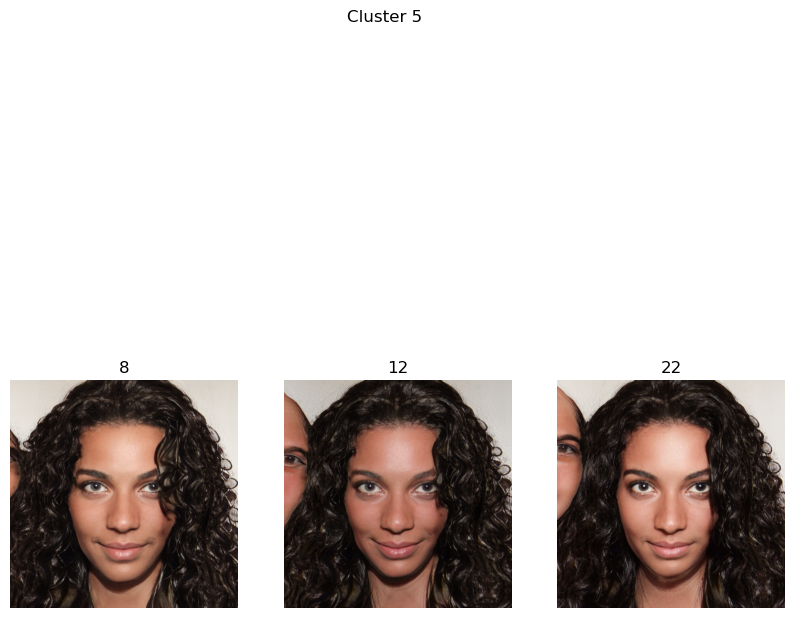

In [40]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Number of clusters
num_clusters = 5  # Adjust this based on your data

# Perform clustering
kmeans = KMeans(n_clusters=num_clusters)
cluster_labels = kmeans.fit_predict(distance_matrix)

# Plotting the clusters with image numbers
for i in range(num_clusters):
    cluster_indices = np.where(cluster_labels == i)[0]
    cluster_images = np.array(images)[cluster_indices]

    plt.figure(figsize=(10, 10))
    plt.suptitle(f"Cluster {i+1}")

    for j, img in enumerate(cluster_images):
        plt.subplot(1, len(cluster_images), j+1)
        plt.imshow(img)
        plt.title(f"{cluster_indices[j]}")
        plt.axis('off')

    plt.show()


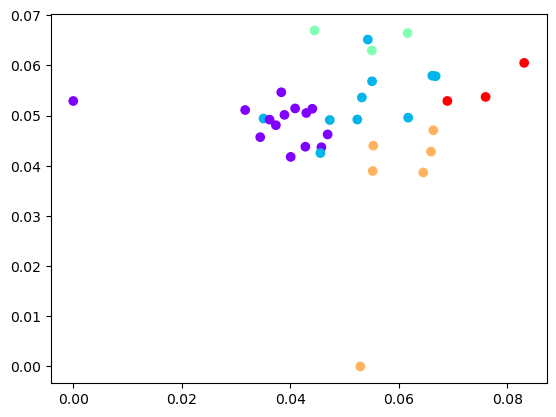

In [41]:
plt.scatter(distance_matrix[:,0], distance_matrix[:,1], c=cluster_labels, cmap='rainbow')

[t-SNE] Computing 4 nearest neighbors...
[t-SNE] Indexed 36 samples in 0.000s...
[t-SNE] Computed neighbors for 36 samples in 0.003s...
[t-SNE] Computed conditional probabilities for sample 36 / 36
[t-SNE] Mean sigma: 1.182902
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.935028
[t-SNE] KL divergence after 300 iterations: 1.248430


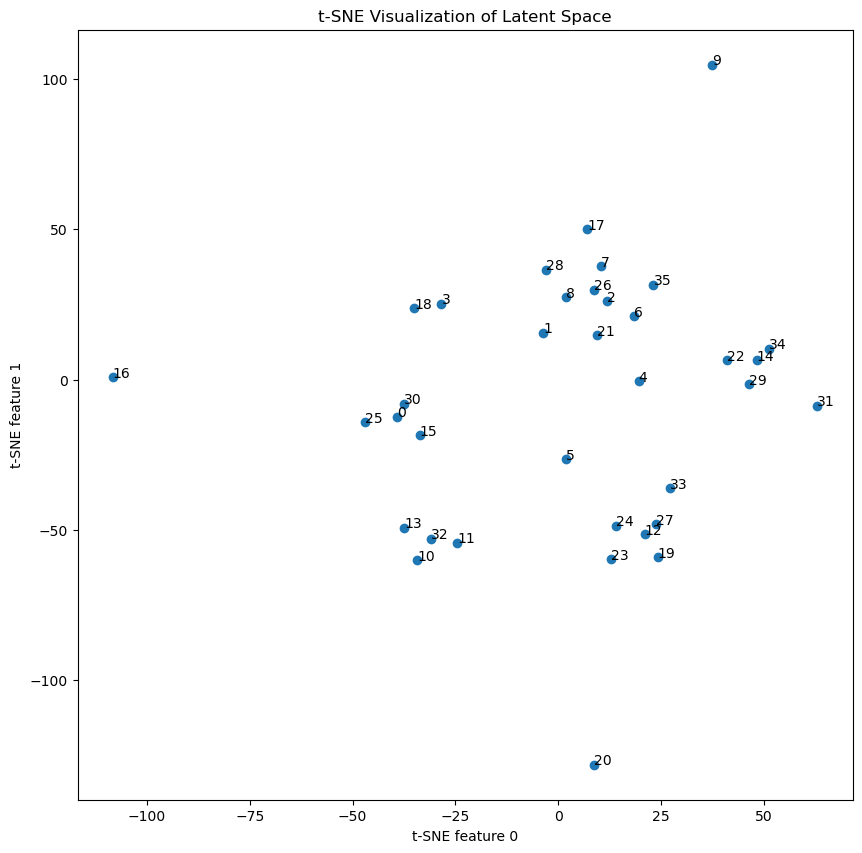

In [42]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# Assuming 'explore' contains your latent vectors
latent_vectors = np.array([v.cpu().numpy().squeeze() for v in explore])

# t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, verbose=1, perplexity=1, n_iter=300)
tsne_results = tsne.fit_transform(latent_vectors)

# Plotting
plt.figure(figsize=(10, 10))
plt.scatter(tsne_results[:, 0], tsne_results[:, 1])

for i, txt in enumerate(range(len(tsne_results))):
    plt.annotate(txt, (tsne_results[i, 0], tsne_results[i, 1]))

#fix the axis
# plt.xlim(-300, 100)
# plt.ylim(-300, 300)
plt.xlabel('t-SNE feature 0')
plt.ylabel('t-SNE feature 1')
plt.title('t-SNE Visualization of Latent Space')
plt.show()